# Predict Toxcast Mechanism
This notebook predicts the mechanism of action for each of the Toxcast profiles referenced in the JBS paper and used as validation data. The data file used is `Berg JBS 2013 Supplemental Table 5 - Profiles.xlsx`. 

## Preprocessing
Ihe Excel file contains all profiles in BioMAP profile format. TargetProcessor removes excess columns not used in the training data and the system `SMC_IL-1b/TNF-a/IFN-g_24` is renamed to `CASMC_HCL_IL-1b/TNF-a/IFN-g_24`.

In [10]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns; sns.set() # set to default
from sklearn.externals import joblib
from IPython.display import display
from scripts.profile_reader2 import ProfileReader, TargetProcessor
from sklearn.svm import SVC


pd.options.display.max_colwidth = 256
pd.options.display.max_columns = 50
pd.options.display.max_rows = 10



data_file='Validation/Berg JBS 2013 Supplemental Table 5 - Profiles.xlsx'
pr = TargetProcessor(data_file=data_file)



Removing extra target colunms: ['HEK/HDFn_IL-1b/TNF-a/IFN-g/TGF-b_24:TGF-betaI', 'BrEPI_IL-1b/TNF-a/IFN-g_24:TGF-betaI', 'HUVEC_IL-1b/TNF-a/IFN-g_24:Visual']


In [12]:
clfs = joblib.load('svm_classifiers.pkl') 
target = pr.get_target()

ptable0 = pd.DataFrame({'Profile': [],
                           'Mechanism': [],
                           'Decision Value': [],
                           'Prediction': []})
for mech, clf in clfs.items():
    pred = clf.predict(target)
    dv = clf.decision_function(target)
    ptable = pd.DataFrame({'Profile': target.index.values,
                           'Mechanism': [mech] * len(target),
                           'Decision Value': dv,
                           'Prediction': pred})
    ptable0 = pd.concat([ptable0, ptable])
    #ptable0 = ptable0[ptable0.Prediction == 1]
    
ptable0 = ptable0[['Profile', 'Mechanism', 'Decision Value', 'Prediction']].sort_values(by=['Profile', 'Decision Value'], ascending=[True, False])

In [13]:
ptable0.head()

,Profile,Mechanism,Decision Value,Prediction
0,"ToxCast_Screen, R1, 6-Deisopropylatrazine, BSK-C005620, 40000 nM",mTOR inhibitor,0.001153,1.0
0,"ToxCast_Screen, R1, 6-Deisopropylatrazine, BSK-C005620, 40000 nM",PDE IV inhibitor,-0.024070,0.0
0,"ToxCast_Screen, R1, 6-Deisopropylatrazine, BSK-C005620, 40000 nM",p38 MAPK inhibitor,-0.071317,0.0
0,"ToxCast_Screen, R1, 6-Deisopropylatrazine, BSK-C005620, 40000 nM",PI3K inhibitor,-0.383660,0.0
0,"ToxCast_Screen, R1, 6-Deisopropylatrazine, BSK-C005620, 40000 nM",PKC (c+n) inhibitor,-0.383676,0.0


In [14]:
p_mech = ptable0.pivot(index='Profile', columns='Mechanism', values='Decision Value')
p_mech

Mechanism,AhR agonist,Calcineurin inhibitor,EGFR inhibitor,EP agonist,ER agonist,GR agonist,H1 antagonist,HDAC inhibitor,HMG-CoA reductase inhibitor,Hsp90 inhibitor,IKK2 inhibitor,IL-17R agonist,JAK inhibitor,MEK inhibitor,Microtubule disruptor,Microtubule stabilizer,Mitochondrial inhibitor,PDE IV inhibitor,PI3K inhibitor,PKC (c+n) inhibitor,Proteasome inhibitor,RAR/RXR agonist,SR Ca++ ATPase inhibitor,Src family inhibitor,TNF-α antagonist,Vitamin D receptor agonist,mTOR inhibitor,p38 MAPK inhibitor
Profile,,,,,,,,,,,,,,,,,,,,,,,,,,,,
"ToxCast_Screen, R1, 6-Deisopropylatrazine, BSK-C005620, 40000 nM",-0.806329,-0.890403,-0.760432,-0.387063,-1.016756,-0.562955,-0.864494,-0.517793,-1.105465,-0.796942,-0.389225,-0.650073,-0.853362,-0.783581,-0.748780,-1.169304,-0.672604,-0.024070,-0.383660,-0.383676,-1.029197,-1.063181,-0.935629,-1.114387,-0.451096,-0.496584,0.001153,-0.071317
"ToxCast_Screen, R1, Acetochlor, BSK-C005622, 13000 nM",-0.895019,-0.771962,-0.905274,-1.208486,-0.258596,-1.416732,-0.520640,-0.457978,-0.384844,-0.529420,-0.947900,-0.713384,-0.473861,-1.439101,-0.151609,-0.292143,0.084171,-0.307242,-0.814631,-0.647338,-0.368516,-0.154577,-0.324607,-0.365592,-1.550709,-1.528235,-0.280892,0.038363
"ToxCast_Screen, R1, Acetochlor, BSK-C005622, 40000 nM",0.059529,0.597600,-0.194793,0.057222,1.594770,-1.427591,0.113732,2.157832,1.044766,1.814966,0.537727,-0.013428,1.058465,-0.602697,1.483590,1.569700,2.119406,2.548249,0.747722,2.450562,1.554099,2.184741,1.316561,1.681193,-0.823398,-0.529138,2.594897,3.087643
"ToxCast_Screen, R1, Alachlor, BSK-C005632, 13000 nM",-1.034030,-0.485702,-1.178676,-1.347812,-0.275391,-1.233444,-0.683433,-0.825899,-0.777293,-0.573347,-1.148661,-0.833157,-0.483273,-1.353989,-0.270648,-0.435916,0.171765,-0.457760,-0.824651,-0.994301,-0.504004,-0.388575,-0.425334,-0.466757,-1.601433,-1.563864,-0.435412,-0.041905
"ToxCast_Screen, R1, Alachlor, BSK-C005632, 1500 nM",-1.071113,-1.260603,-1.241227,-1.623069,-1.093722,-1.219290,-0.987358,-1.368730,-1.032956,-1.340104,-1.469051,-0.869169,-1.007076,-1.611968,-0.996424,-1.189419,-1.011398,-1.190669,-1.401541,-1.483777,-1.156631,-1.159630,-1.114711,-1.251508,-1.556345,-1.579039,-1.404049,-1.060323
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"ToxCast_Screen, R1, Triticonazole, BSK-C005760, 4400 nM",-1.191100,-1.188130,-0.633935,-1.016509,-1.105667,-1.302785,-1.039546,-0.765838,-0.116443,-0.857512,-1.216962,-0.923592,-1.237079,-1.640756,-0.474300,0.002471,-0.721422,-1.013065,-1.081731,-1.167037,-0.679286,-0.430173,-1.017778,-0.333453,-1.446481,-1.252411,-1.003781,-1.155334
"ToxCast_Screen, R2, Dibutyl Phthalate, BSK-C005615, 13000 nM",-0.963213,-0.982523,-0.921102,-1.345054,-0.851179,-1.147889,-0.930310,-1.104318,-1.040738,-1.087181,-0.996700,-0.984092,-0.834201,-1.271887,-0.952131,-1.067406,-0.907490,-0.956903,-0.925499,-1.027386,-0.978875,-1.100898,-1.085709,-1.169377,-1.129232,-1.216697,-0.986497,-0.702707
"ToxCast_Screen, R2, Dibutyl Phthalate, BSK-C005615, 1500 nM",-1.168567,-0.999048,-0.820025,-1.253895,-0.897333,-1.196793,-1.039755,-1.084009,-0.938105,-0.971577,-0.989697,-1.217419,-0.805743,-1.070281,-0.951571,-0.943828,-0.833121,-1.038817,-0.903976,-0.967918,-0.900293,-0.981325,-0.971137,-0.961234,-1.056692,-1.075103,-0.883351,-0.800142


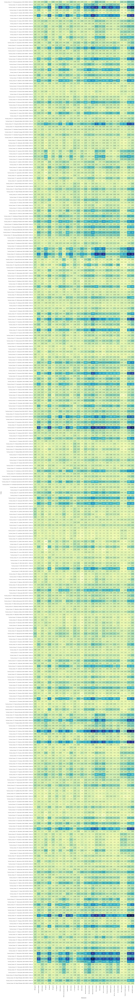

In [15]:
plt.figure(figsize=(20, 200))
ax = sns.heatmap(p_mech, annot=True, fmt=".2", cmap='YlGnBu', cbar=None)

# Plotting mechanism prediction one-by-one

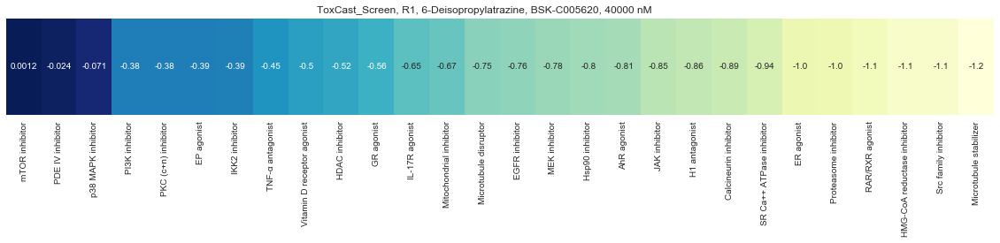

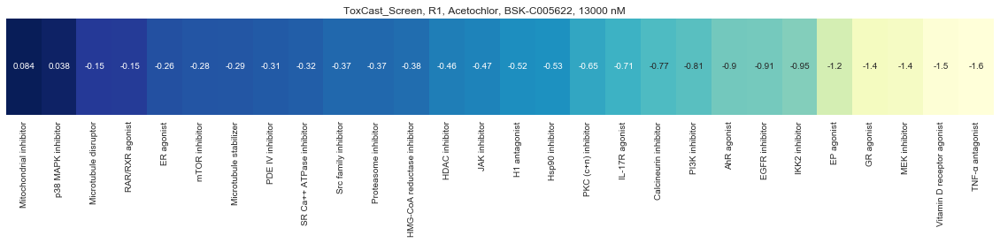

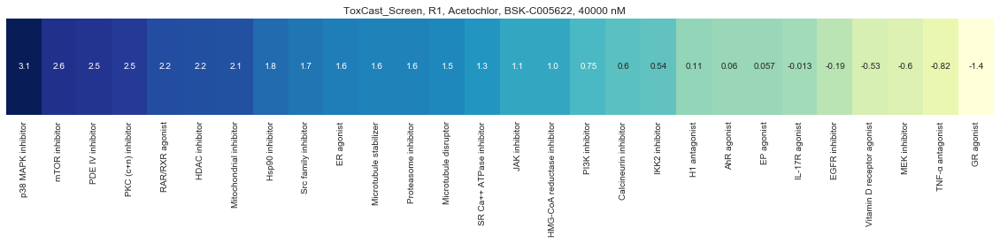

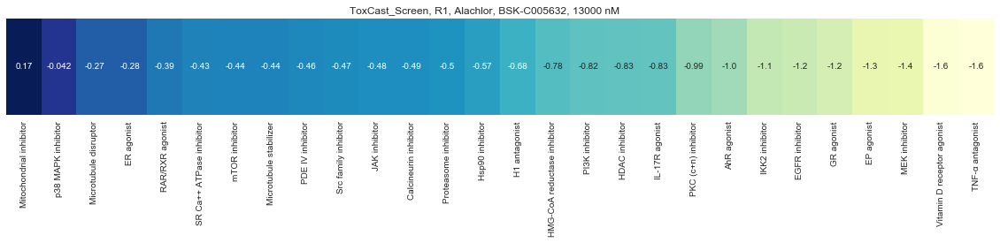

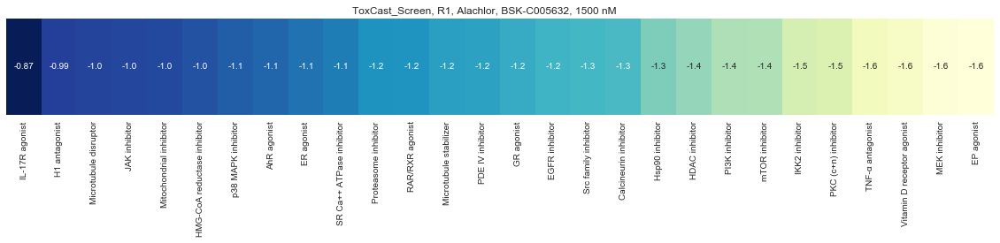

...

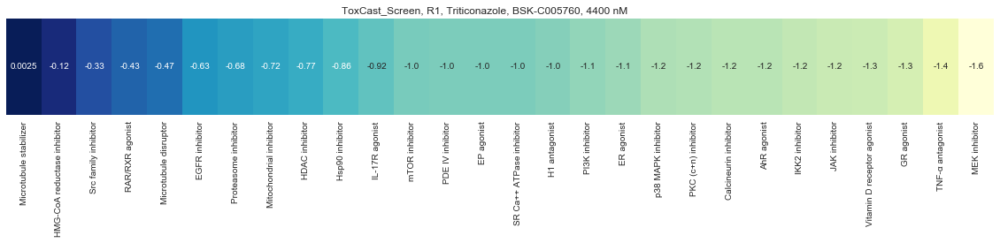

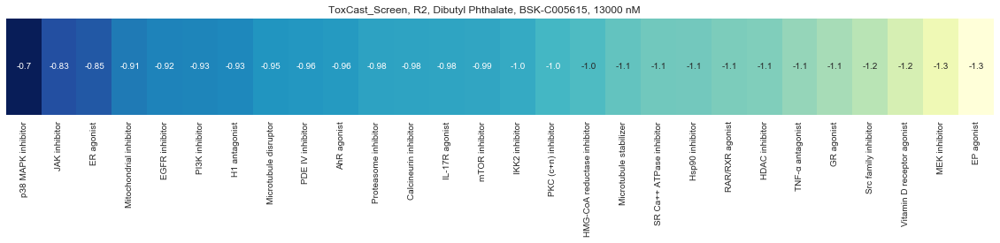

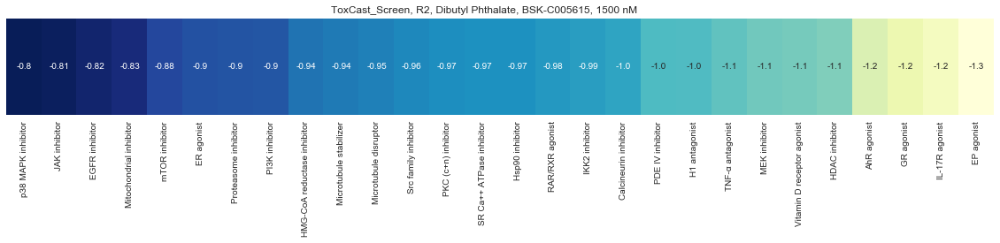

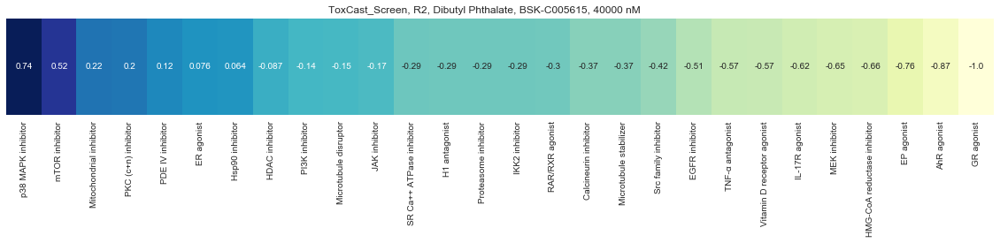

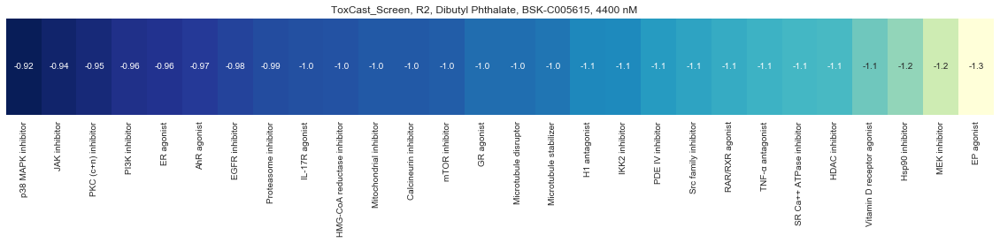

In [6]:
for mech in p_mech.index.values:
    plt.figure(figsize=(20, 2))
    df =pd.DataFrame(p_mech.loc[mech]).sort_values(mech, ascending=False).T
    ax = sns.heatmap(df, annot=True, fmt=".2", cmap='YlGnBu', cbar=False, yticklabels=[]) 
    plt.suptitle(mech)
    plt.xlabel('')
    
    plt.show()